# Model Maker

In [1]:
import turicreate as tc
from copy import deepcopy
from math import floor

## Import Data

In [2]:
images = tc.load_images("./Cards")

In [3]:
pathes = images['path']

In [4]:
annotations = tc.SFrame("./out.csv")

Finished parsing file /Users/ryangaines/Google Drive/Fall 2018/CS 499/PokerHandRecognizer/out.csv

Parsing completed. Parsed 100 lines in 0.033506 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[str,str,int,int,int,int]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Finished parsing file /Users/ryangaines/Google Drive/Fall 2018/CS 499/PokerHandRecognizer/out.csv

Parsing completed. Parsed 1040 lines in 0.007514 secs.

In [5]:
annotations

path,name,xMin,xMax,yMin,yMax
./Cards/IMG_2634.jpeg,Card,1167,1860,1532,2466
./Cards/IMG_2634.jpeg,Diamond,1194,1254,1696,1773
./Cards/IMG_2634.jpeg,Diamond,1766,1840,2235,2319
./Cards/IMG_2634.jpeg,Ace,1184,1268,1573,1686
./Cards/IMG_2634.jpeg,Ace,1756,1847,2326,2439
./Cards/IMG_2663.jpeg,Card,1078,2036,1658,2331
./Cards/IMG_2663.jpeg,Three,1111,1231,2228,2309
./Cards/IMG_2663.jpeg,Diamond,1234,1315,2245,2305
./Cards/IMG_2663.jpeg,Diamond,1796,1877,1676,1740
./Cards/IMG_2663.jpeg,Three,1877,1994,1666,1753


In [6]:
finalList = {}
finalPath = []
finalDict = []
currPathDict = []
currPath = annotations['path'][0]
for i in annotations:
    if i['path'] == currPath:
        instance = {'coordinates': {'height': i['yMax'] - i['yMin'], 'width': i['xMax'] - i['xMin'], 'x': floor((i['xMax'] + i['xMin'])/2), 'y': floor((i['yMax'] + i['yMin'])/2)},'label': i['name']}
        currPathDict.append(instance)
    else:               
        finalPath.append(currPath)
        finalDict.append(deepcopy(currPathDict))
        finalList[currPath] = deepcopy(currPathDict)
        currPath = i['path']
        currPathDict =[]
        instance = {'coordinates': {'height': i['yMax'] - i['yMin'], 'width': i['xMax'] - i['xMin'], 'x': floor((i['xMax'] + i['xMin'])/2), 'y': floor((i['yMax'] + i['yMin'])/2)},'label': i['name']}
        currPathDict.append(instance)
finalList[currPath] = deepcopy(currPathDict)
finalPath.append(currPath)
finalDict.append(deepcopy(currPathDict))


In [7]:
finalDict

[[{'coordinates': {'height': 934, 'width': 693, 'x': 1513, 'y': 1999},
   'label': 'Card'},
  {'coordinates': {'height': 77, 'width': 60, 'x': 1224, 'y': 1734},
   'label': 'Diamond'},
  {'coordinates': {'height': 84, 'width': 74, 'x': 1803, 'y': 2277},
   'label': 'Diamond'},
  {'coordinates': {'height': 113, 'width': 84, 'x': 1226, 'y': 1629},
   'label': 'Ace'},
  {'coordinates': {'height': 113, 'width': 91, 'x': 1801, 'y': 2382},
   'label': 'Ace'}],
 [{'coordinates': {'height': 673, 'width': 958, 'x': 1557, 'y': 1994},
   'label': 'Card'},
  {'coordinates': {'height': 81, 'width': 120, 'x': 1171, 'y': 2268},
   'label': 'Three'},
  {'coordinates': {'height': 60, 'width': 81, 'x': 1274, 'y': 2275},
   'label': 'Diamond'},
  {'coordinates': {'height': 64, 'width': 81, 'x': 1836, 'y': 1708},
   'label': 'Diamond'},
  {'coordinates': {'height': 87, 'width': 117, 'x': 1935, 'y': 1709},
   'label': 'Three'}],
 [{'coordinates': {'height': 669, 'width': 956, 'x': 1502, 'y': 2071},
   'lab

In [8]:
sa = tc.SArray(data=finalPath)

In [9]:
sa2 = tc.SArray(data=finalDict)

In [10]:
len(sa2)

208

In [11]:
sf = tc.SFrame({'path':sa,'annotations':sa2})

In [12]:
sf

annotations,path
"[{'coordinates':{'height': 934, 'width': ...",./Cards/IMG_2634.jpeg
"[{'coordinates':{'height': 673, 'width': ...",./Cards/IMG_2663.jpeg
"[{'coordinates':{'height': 669, 'width': ...",./Cards/IMG_2675.jpeg
"[{'coordinates':{'height': 974, 'width': ...",./Cards/IMG_2622.jpeg
"[{'coordinates':{'height': 659, 'width': ...",./Cards/IMG_2659.jpeg
"[{'coordinates':{'height': 943, 'width': ...",./Cards/IMG_2570.jpeg
"[{'coordinates':{'height': 953, 'width': ...",./Cards/IMG_2618.jpeg
"[{'coordinates':{'height': 981, 'width': ...",./Cards/IMG_2531.jpeg
"[{'coordinates':{'height': 930, 'width': ...",./Cards/IMG_2589.jpeg
"[{'coordinates':{'height': 937, 'width': ...",./Cards/IMG_2566.jpeg


In [13]:
data = images.join(sf)

In [14]:
data

path,image,annotations
./Cards/IMG_2634.jpeg,Height: 4032 Width: 3024,"[{'coordinates':{'height': 934, 'width': ..."
./Cards/IMG_2663.jpeg,Height: 4032 Width: 3024,"[{'coordinates':{'height': 673, 'width': ..."
./Cards/IMG_2675.jpeg,Height: 4032 Width: 3024,"[{'coordinates':{'height': 669, 'width': ..."
./Cards/IMG_2622.jpeg,Height: 4032 Width: 3024,"[{'coordinates':{'height': 974, 'width': ..."
./Cards/IMG_2659.jpeg,Height: 4032 Width: 3024,"[{'coordinates':{'height': 659, 'width': ..."
./Cards/IMG_2570.jpeg,Height: 4032 Width: 3024,"[{'coordinates':{'height': 943, 'width': ..."
./Cards/IMG_2618.jpeg,Height: 4032 Width: 3024,"[{'coordinates':{'height': 953, 'width': ..."
./Cards/IMG_2531.jpeg,Height: 4032 Width: 3024,"[{'coordinates':{'height': 981, 'width': ..."
./Cards/IMG_2589.jpeg,Height: 4032 Width: 3024,"[{'coordinates':{'height': 930, 'width': ..."
./Cards/IMG_2566.jpeg,Height: 4032 Width: 3024,"[{'coordinates':{'height': 937, 'width': ..."


In [15]:
train_data, test_data = data.random_split(0.8)

In [16]:
test_data['bounding'] = tc.object_detector.util.draw_bounding_boxes(test_data['image'], test_data['annotations'])

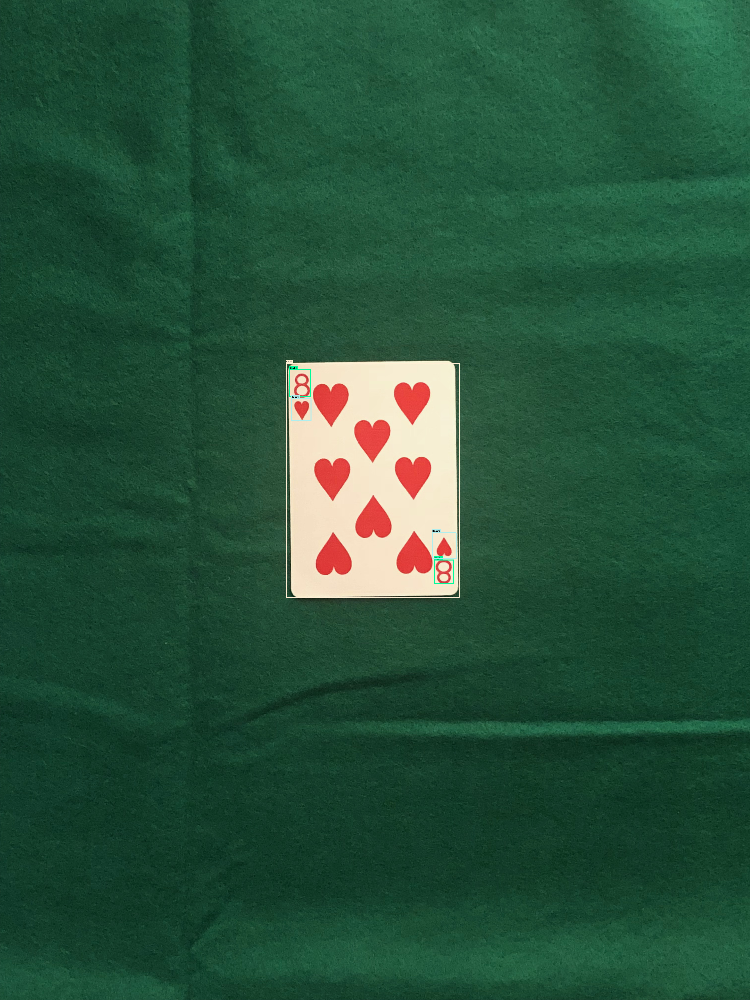

In [17]:
test_data['bounding'][1].show()

In [ ]:
model = tc.object_detector.create(train_data, max_iterations=1000)

Using 'image' as feature column
Using 'annotations' as annotations column
Setting 'batch_size' to 32
Using CPU to create model
+--------------+--------------+--------------+
| Iteration    | Loss         | Elapsed Time |
+--------------+--------------+--------------+
| 1            | 14.281       | 42.5         |
| 2            | 14.285       | 82.1         |
| 3            | 14.287       | 116.2        |
| 4            | 14.280       | 150.7        |


In [19]:
model.save("test.model")

In [20]:
predictions = model.predict(test_data)

Predicting  1/46
Predicting 33/46
Predicting 46/46


In [21]:
predictions[2]

[{'label': 'Diamond',
  'type': 'rectangle',
  'coordinates': {'x': 1882.8437467018084,
   'y': 2564.6006281097903,
   'width': 76.61462094233616,
   'height': 97.2469253540039},
  'confidence': 0.5138598098964661},
 {'label': 'Card',
  'type': 'rectangle',
  'coordinates': {'x': 2471.564650443791,
   'y': 3215.373785507918,
   'width': 619.959090306209,
   'height': 1021.116397564228},
  'confidence': 0.4446623492257748},
 {'label': 'Diamond',
  'type': 'rectangle',
  'coordinates': {'x': 1849.7668562916688,
   'y': 2562.53224819467,
   'width': 61.77527596400341,
   'height': 91.0943874946006},
  'confidence': 0.3871257415930478},
 {'label': 'Card',
  'type': 'rectangle',
  'coordinates': {'x': 2649.2699693499826,
   'y': 2975.828660751626,
   'width': 585.4251418480508,
   'height': 1221.8322495680586},
  'confidence': 0.29990208547172026}]

In [22]:
predictions

dtype: list
Rows: 46
[[{'label': 'Card', 'type': 'rectangle', 'coordinates': {'x': 2441.7190158029816, 'y': 3206.9741732337075, 'width': 644.2827177781323, 'height': 987.0665764441856}, 'confidence': 0.6543291989843114}, {'label': 'Heart', 'type': 'rectangle', 'coordinates': {'x': 1882.06227663431, 'y': 2648.5996172135783, 'width': 74.19331411214989, 'height': 97.22937231797414}, 'confidence': 0.3245056732727762}, {'label': 'Heart', 'type': 'rectangle', 'coordinates': {'x': 1848.6032395569687, 'y': 2663.763731080753, 'width': 76.65822623326244, 'height': 101.24179854759814}, 'confidence': 0.27299239478243226}], [{'label': 'Card', 'type': 'rectangle', 'coordinates': {'x': 2509.103173502721, 'y': 3211.1673865638263, 'width': 897.6199466998764, 'height': 741.1430511474609}, 'confidence': 0.624910353822578}], [{'label': 'Diamond', 'type': 'rectangle', 'coordinates': {'x': 1882.8437467018084, 'y': 2564.6006281097903, 'width': 76.61462094233616, 'height': 97.2469253540039}, 'confidence': 0.5

In [23]:
test_data

path,image,annotations
./Cards/IMG_2634.jpeg,Height: 4032 Width: 3024,"[{'coordinates':{'height': 934, 'width': ..."
./Cards/IMG_2659.jpeg,Height: 4032 Width: 3024,"[{'coordinates':{'height': 659, 'width': ..."
./Cards/IMG_2531.jpeg,Height: 4032 Width: 3024,"[{'coordinates':{'height': 981, 'width': ..."
./Cards/IMG_2638.jpeg,Height: 4032 Width: 3024,"[{'coordinates':{'height': 967, 'width': ..."
./Cards/IMG_2546.jpeg,Height: 4032 Width: 3024,"[{'coordinates':{'height': 930, 'width': ..."
./Cards/IMG_2679.jpeg,Height: 4032 Width: 3024,"[{'coordinates':{'height': 676, 'width': ..."
./Cards/IMG_2507.jpeg,Height: 4032 Width: 3024,"[{'coordinates':{'height': 984, 'width': ..."
./Cards/IMG_2655.jpeg,Height: 4032 Width: 3024,"[{'coordinates':{'height': 693, 'width': ..."
./Cards/IMG_2602.jpeg,Height: 4032 Width: 3024,"[{'coordinates':{'height': 963, 'width': ..."
./Cards/IMG_2643.jpeg,Height: 4032 Width: 3024,"[{'coordinates':{'height': 666, 'width': ..."


In [24]:
test_data['predicted'] = tc.object_detector.util.draw_bounding_boxes(test_data['image'], predictions)

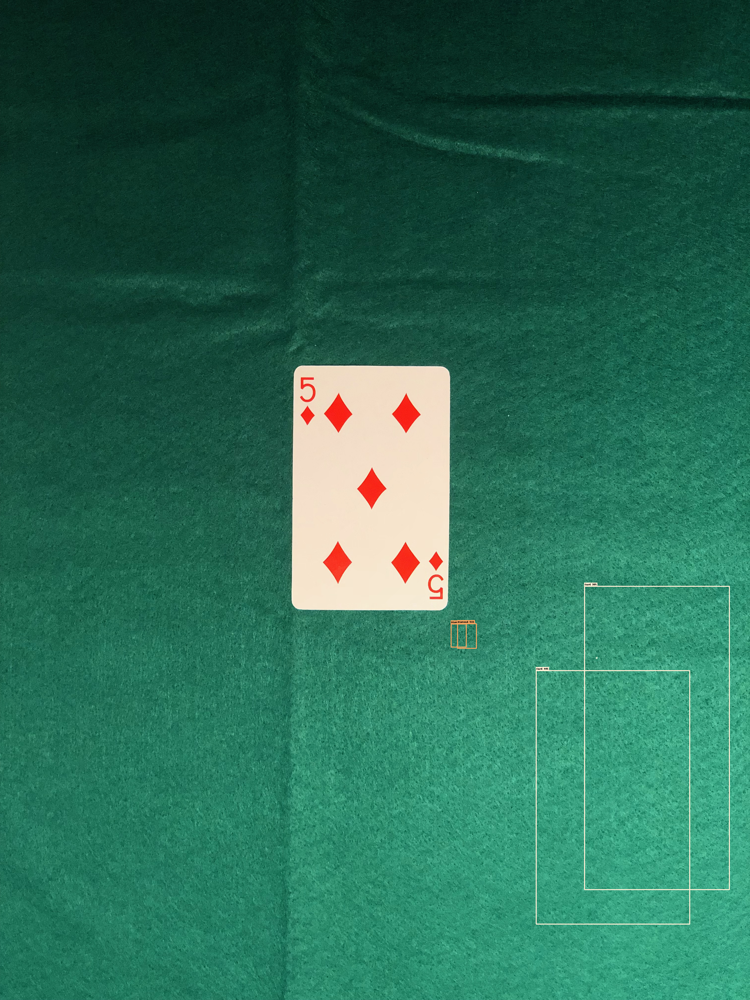

In [26]:
test_data['predicted'][2].show()